# prosperLoanData Exploration
## by Mohamed Adel

## Preliminary Wrangling

> This data set contains 113,937 loans with 81 variables on each
loan, including loan amount, borrower rate (or interest rate),
current loan status, borrower income, and many others.

In [19]:
# import all packages and set plots to be embedded inline
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import StandardScaler
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sb

%matplotlib inline

> Load in your dataset and describe its properties through the questions below.
Try and motivate your exploration goals through this section.

In [20]:
# load in the dataset into a pandas dataframe, print statistics
PLD = pd.read_csv('prosperLoanData.csv', dtype = {'LoanStatus' : str})

In [5]:
PLD.head(5)

,ListingKey,ListingNumber,ListingCreationDate,CreditGrade,Term,LoanStatus,ClosedDate,BorrowerAPR,BorrowerRate,LenderYield,...,LP_ServiceFees,LP_CollectionFees,LP_GrossPrincipalLoss,LP_NetPrincipalLoss,LP_NonPrincipalRecoverypayments,PercentFunded,Recommendations,InvestmentFromFriendsCount,InvestmentFromFriendsAmount,Investors
0,1021339766868145413AB3B,193129,2007-08-26 19:09:29.263000000,C,36,Completed,2009-08-14 00:00:00,0.16516,0.1580,0.1380,...,-133.18,0.0,0.0,0.0,0.0,1.0,0,0,0.0,258
1,10273602499503308B223C1,1209647,2014-02-27 08:28:07.900000000,NaN,36,Current,NaN,0.12016,0.0920,0.0820,...,0.00,0.0,0.0,0.0,0.0,1.0,0,0,0.0,1
2,0EE9337825851032864889A,81716,2007-01-05 15:00:47.090000000,HR,36,Completed,2009-12-17 00:00:00,0.28269,0.2750,0.2400,...,-24.20,0.0,0.0,0.0,0.0,1.0,0,0,0.0,41
3,0EF5356002482715299901A,658116,2012-10-22 11:02:35.010000000,NaN,36,Current,NaN,0.12528,0.0974,0.0874,...,-108.01,0.0,0.0,0.0,0.0,1.0,0,0,0.0,158
4,0F023589499656230C5E3E2,909464,2013-09-14 18:38:39.097000000,NaN,36,Current,NaN,0.24614,0.2085,0.1985,...,-60.27,0.0,0.0,0.0,0.0,1.0,0,0,0.0,20


In [6]:
# high-level overview of data shape and composition
print(PLD.shape)
print(PLD.dtypes)
print(PLD.head(10))

(113937, 81)
ListingKey                              object
ListingNumber                            int64
ListingCreationDate                     object
CreditGrade                             object
Term                                     int64
LoanStatus                              object
ClosedDate                              object
BorrowerAPR                            float64
BorrowerRate                           float64
LenderYield                            float64
EstimatedEffectiveYield                float64
EstimatedLoss                          float64
EstimatedReturn                        float64
ProsperRating (numeric)                float64
ProsperRating (Alpha)                   object
ProsperScore                           float64
ListingCategory (numeric)                int64
BorrowerState                           object
Occupation                              object
EmploymentStatus                        object
EmploymentStatusDuration               float64


In [7]:
PLD.nunique()

ListingKey                             113066
ListingNumber                          113066
ListingCreationDate                    113064
CreditGrade                                 8
Term                                        3
LoanStatus                                 12
ClosedDate                               2802
BorrowerAPR                              6677
BorrowerRate                             2294
LenderYield                              2283
EstimatedEffectiveYield                  1582
EstimatedLoss                             120
EstimatedReturn                          1476
ProsperRating (numeric)                     7
ProsperRating (Alpha)                       7
ProsperScore                               11
ListingCategory (numeric)                  21
BorrowerState                              51
Occupation                                 67
EmploymentStatus                            8
EmploymentStatusDuration                  605
IsBorrowerHomeowner               

In [21]:
ordinal_var_dict = {'LoanStatus': ['FinalPaymentInProgress','Current','Completed' ,'Defaulted','Chargedoff','Past Due (61-90 days)'
                                   ,'Past Due (31-60 days)','Past Due (>120 days)','Past Due (91-120 days)','Past Due (16-30 days)'],
                    'ProsperRating (Alpha)': ['A', 'AA', 'B', 'C', 'D', 'E', 'HR'],
                    'EmploymentStatus': ['Self-employed' , 'Employed' ,'Not available', 'Full-time', 'Other', 
                                         'Retired' , 'Part-time']}

for var in ordinal_var_dict:
    ordered_var = pd.api.types.CategoricalDtype(ordered = True,
                                                categories = ordinal_var_dict[var])
    PLD[var] = PLD[var].astype(ordered_var)

In [22]:
PLD[PLD.isnull().any(axis=1)].count()

ListingKey                             113937
ListingNumber                          113937
ListingCreationDate                    113937
CreditGrade                             28953
Term                                   113937
LoanStatus                             113126
ClosedDate                              55089
BorrowerAPR                            113912
BorrowerRate                           113937
LenderYield                            113937
EstimatedEffectiveYield                 84853
EstimatedLoss                           84853
EstimatedReturn                         84853
ProsperRating (numeric)                 84853
ProsperRating (Alpha)                   84853
ProsperScore                            84853
ListingCategory (numeric)              113937
BorrowerState                          108422
Occupation                             110349
EmploymentStatus                       110847
EmploymentStatusDuration               106312
IsBorrowerHomeowner               

In [23]:
print(PLD.describe())

       ListingNumber           Term    BorrowerAPR   BorrowerRate  \
count   1.139370e+05  113937.000000  113912.000000  113937.000000   
mean    6.278857e+05      40.830248       0.218828       0.192764   
std     3.280762e+05      10.436212       0.080364       0.074818   
min     4.000000e+00      12.000000       0.006530       0.000000   
25%     4.009190e+05      36.000000       0.156290       0.134000   
50%     6.005540e+05      36.000000       0.209760       0.184000   
75%     8.926340e+05      36.000000       0.283810       0.250000   
max     1.255725e+06      60.000000       0.512290       0.497500   

         LenderYield  EstimatedEffectiveYield  EstimatedLoss  EstimatedReturn  \
count  113937.000000             84853.000000   84853.000000     84853.000000   
mean        0.182701                 0.168661       0.080306         0.096068   
std         0.074516                 0.068467       0.046764         0.030403   
min        -0.010000                -0.182700       0.

In [24]:
PLD.head(0)

,ListingKey,ListingNumber,ListingCreationDate,CreditGrade,Term,LoanStatus,ClosedDate,BorrowerAPR,BorrowerRate,LenderYield,...,LP_ServiceFees,LP_CollectionFees,LP_GrossPrincipalLoss,LP_NetPrincipalLoss,LP_NonPrincipalRecoverypayments,PercentFunded,Recommendations,InvestmentFromFriendsCount,InvestmentFromFriendsAmount,Investors


because Prosper has only been using its own proprietary Prosper Rating since 2009, we have a lot of missing ProsperRating column values. Let's get these missing values dropped:

In [25]:
PLD = PLD.dropna(subset=['ProsperRating (Alpha)']).reset_index()

In [26]:
PLD['LoanOriginationDate'] = pd.to_datetime(PLD['LoanOriginationDate'])

In [27]:
PLD.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 84853 entries, 0 to 84852
Data columns (total 82 columns):
index                                  84853 non-null int64
ListingKey                             84853 non-null object
ListingNumber                          84853 non-null int64
ListingCreationDate                    84853 non-null object
CreditGrade                            0 non-null object
Term                                   84853 non-null int64
LoanStatus                             84047 non-null category
ClosedDate                             26005 non-null object
BorrowerAPR                            84853 non-null float64
BorrowerRate                           84853 non-null float64
LenderYield                            84853 non-null float64
EstimatedEffectiveYield                84853 non-null float64
EstimatedLoss                          84853 non-null float64
EstimatedReturn                        84853 non-null float64
ProsperRating (numeric)             

because there is no previous credit history on Prosper the value for column TotalProsperLoans will be NaN, let's replace it with 0.

In [28]:
PLD['TotalProsperLoans'] = PLD['TotalProsperLoans'].fillna(0)

In [29]:
PLD.head(5)

,index,ListingKey,ListingNumber,ListingCreationDate,CreditGrade,Term,LoanStatus,ClosedDate,BorrowerAPR,BorrowerRate,...,LP_ServiceFees,LP_CollectionFees,LP_GrossPrincipalLoss,LP_NetPrincipalLoss,LP_NonPrincipalRecoverypayments,PercentFunded,Recommendations,InvestmentFromFriendsCount,InvestmentFromFriendsAmount,Investors
0,1,10273602499503308B223C1,1209647,2014-02-27 08:28:07.900000000,NaN,36,Current,NaN,0.12016,0.0920,...,0.00,0.0,0.0,0.0,0.0,1.0,0,0,0.0,1
1,3,0EF5356002482715299901A,658116,2012-10-22 11:02:35.010000000,NaN,36,Current,NaN,0.12528,0.0974,...,-108.01,0.0,0.0,0.0,0.0,1.0,0,0,0.0,158
2,4,0F023589499656230C5E3E2,909464,2013-09-14 18:38:39.097000000,NaN,36,Current,NaN,0.24614,0.2085,...,-60.27,0.0,0.0,0.0,0.0,1.0,0,0,0.0,20
3,5,0F05359734824199381F61D,1074836,2013-12-14 08:26:37.093000000,NaN,60,Current,NaN,0.15425,0.1314,...,-25.33,0.0,0.0,0.0,0.0,1.0,0,0,0.0,1
4,6,0F0A3576754255009D63151,750899,2013-04-12 09:52:56.147000000,NaN,36,Current,NaN,0.31032,0.2712,...,-22.95,0.0,0.0,0.0,0.0,1.0,0,0,0.0,1


### What is the structure of your dataset?

> ### What is the structure of your dataset?

There are 113937 loan data in the dataset with 82 features (ListingKey, ListingNumber, ListingCreationDate, CreditGrade, Term, LoanStatus, ClosedDate, BorrowerAPR, BorrowerRate,...etc). ( 61 colum ) Most variables are numeric in nature, but the variables EmploymentStatus, LoanStatus, ProsperRating (Alpha), and BorrowerState are ordered factor variables

### What is/are the main feature(s) of interest in your dataset?

I'm most interested in figuring out what features are best for predicting the proposer loans rate of success in the dataset.

### What features in the dataset do you think will help support your investigation into your feature(s) of interest?

I expect that borrower APR will have the strongest effect on each rate of success proposer loans: the length of the loan expressed in months (term) ,The Borrower's interest rate for this loan (BorrowerRate) ,LoanOriginalAmount .

## Univariate Exploration

I'll start by looking at the distribution of the main variable of interest: the proposer loans rate of success.

## Univariate Exploration

> In this section, investigate distributions of individual variables. If
you see unusual points or outliers, take a deeper look to clean things up
and prepare yourself to look at relationships between variables.

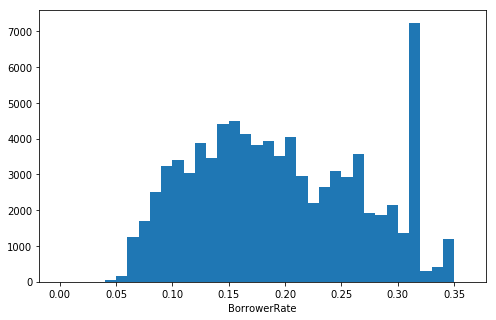

In [17]:
binsize = 0.01
bins = np.arange(0, PLD['BorrowerRate'].max()+binsize, binsize)

plt.figure(figsize=[8, 5])
plt.hist(data = PLD, x = 'BorrowerRate', bins = bins)
plt.xlabel('BorrowerRate')
plt.show()

The distribution of the borrower rate apears to be bimodal with first peak around 0.16, larger peak (true mode) around 0.32. Let's check number of occurrences:

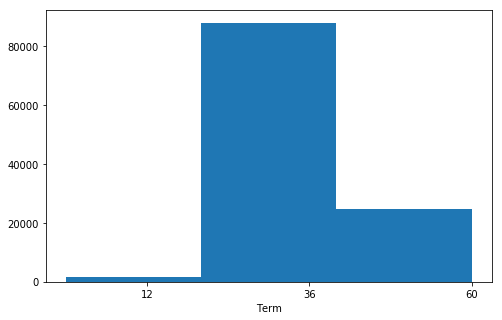

In [4]:
binsize = 20
bins = np.arange(0, PLD['Term'].max()+binsize, binsize)

plt.figure(figsize=[8, 5])
plt.hist(data = PLD, x = 'Term', bins = bins)
plt.xticks([12 ,36 ,60])
plt.xlabel('Term')
plt.show()

For loan terms there are three options: 36, 60 and 12. Most common is 36 months.

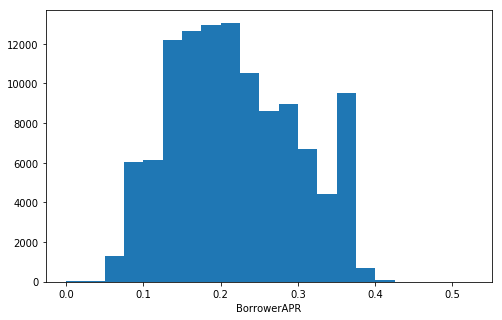

In [15]:
binsize = 0.025
bins = np.arange(0, PLD['BorrowerAPR'].max()+binsize, binsize)

plt.figure(figsize=[8, 5])
plt.hist(data = PLD, x = 'BorrowerAPR', bins = bins)
plt.xlabel('BorrowerAPR')
plt.show()

the maximam APR rate are between 0.2 more or less  

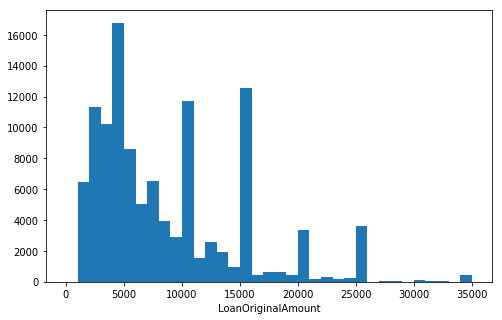

In [8]:
binsize = 1000
bins = np.arange(0, PLD['LoanOriginalAmount'].max()+binsize, binsize)

plt.figure(figsize=[8, 5])
plt.hist(data = PLD, x = 'LoanOriginalAmount', bins = bins)
plt.xlabel('LoanOriginalAmount')
plt.show()

most loans are less than 10000 bound

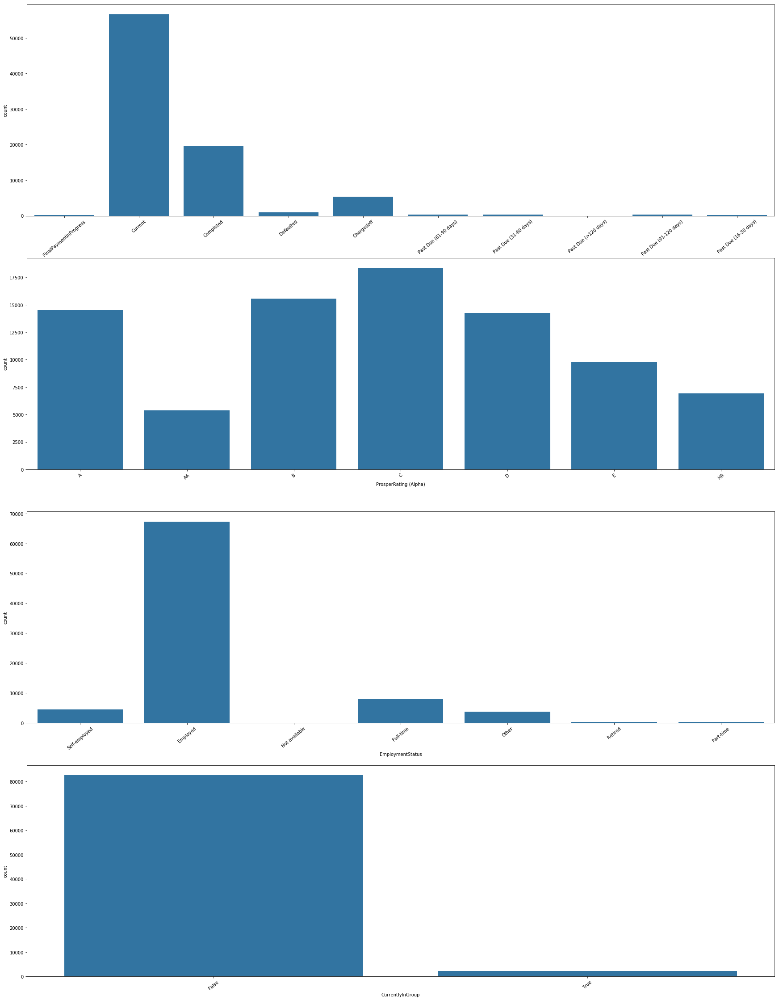

In [31]:
# let's plot all three together to get an idea of each ordinal variable's distribution.

fig, ax = plt.subplots(nrows=4, figsize = [30,40])

default_color = sb.color_palette()[0]


sb.countplot(data = PLD, x = 'LoanStatus', color = default_color, ax = ax[0] )
#plt.xticks(rotation=50)
sb.countplot(data = PLD, x = 'ProsperRating (Alpha)', color = default_color, ax = ax[1])
sb.countplot(data = PLD, x = 'EmploymentStatus', color = default_color, ax = ax[2])
sb.countplot(data = PLD, x = 'CurrentlyInGroup', color = default_color, ax = ax[3])

for ax in fig.axes:
    plt.sca(ax)
    plt.xticks(rotation=40)
plt.show()

tips:
1. most of loans are currently paid or n un compiletly paid
2. Interestingly enough ratings are almost normally distributed with the highest AA rating and the lowest rating HR are the least common and average rating C being the most common
3. most loan carriyers (borrower) are employed
4. most loan carriyers (borrower) are not in group

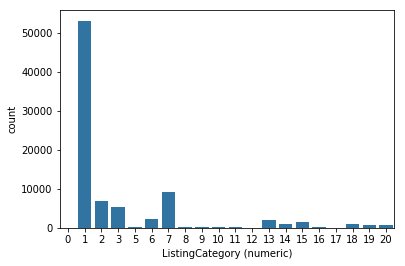

In [36]:
sb.countplot(data=PLD, x='ListingCategory (numeric)', color=default_color)


The category of the listing that the borrower selected when posting their listing: 0 - Not Available, 1 - Debt Consolidation, 2 - Home Improvement, 3 - Business, 4 - Personal Loan, 5 - Student Use, 6 - Auto, 7- Other, 8 - Baby&Adoption, 9 - Boat, 10 - Cosmetic Procedure, 11 - Engagement Ring, 12 - Green Loans, 13 - Household Expenses, 14 - Large Purchases, 15 - Medical/Dental, 16 - Motorcycle, 17 - RV, 18 - Taxes, 19 - Vacation, 20 - Wedding Loans

The overwhelming majority of loans are used for debt consolidation. Other notable categories include Other, Auto, Home Improvement and Business.

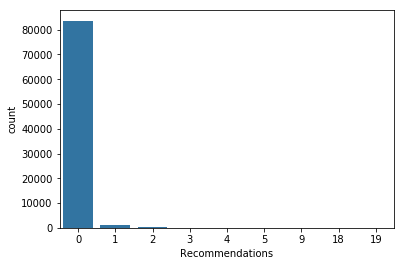

In [38]:
sb.countplot(data=PLD, x='Recommendations', color=default_color);

Overwhelming majority of loans obtained without recomendations.

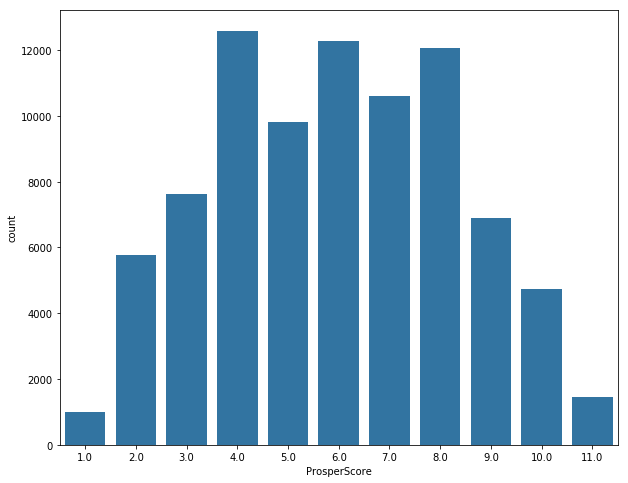

In [51]:
fig = plt.subplots(figsize = [10,8])

default_color = sb.color_palette()[0]

sb.countplot(data = PLD, x = 'ProsperScore', color = default_color )

plt.show()

ProsperScore :A custom risk score built using historical Prosper data. The score ranges from 1-10, with 10 being the best, or lowest risk score. Applicable for loans originated after July 2009. are normally disttributed.

### Discuss the distribution(s) of your variable(s) of interest. Were there any unusual points? Did you need to perform any transformations?

> Prosper ratings are almost normally distributed.ProsperScore are normally distributed .The distribution of borrowers APR looks multimodal. Most of the values are at the range of 0.05 and 0.4. There are no unusual points and no need to perform any transformations.

### Of the features you investigated, were there any unusual distributions? Did you perform any operations on the data to tidy, adjust, or change the form of the data? If so, why did you do this?

> the count plots are normally distributed at most no need for any operations

## Bivariate Exploration

> In this section, investigate relationships between pairs of variables in your
data. Make sure the variables that you cover here have been introduced in some
fashion in the previous section (univariate exploration).

In [32]:
numeric_vars = ['Term', 'BorrowerAPR', 'BorrowerRate', 'LenderYield', 'EstimatedEffectiveYield', 'EstimatedLoss', 'StatedMonthlyIncome','LoanOriginalAmount',
               'ProsperScore']
categoric_vars = ['LoanStatus','ProsperRating (Alpha)','EmploymentStatus' ,'ProsperRating (Alpha)','IsBorrowerHomeowner','CurrentlyInGroup']

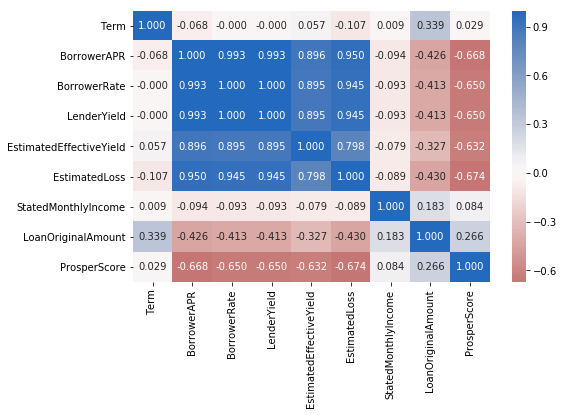

In [33]:
# correlation plot
plt.figure(figsize = [8, 5])
sb.heatmap(PLD[numeric_vars].corr(), annot = True, fmt = '.3f',
           cmap = 'vlag_r', center = 0)
plt.show()

BorrowerAPR and ProsperScore are negative because borrowers with lower score are more likely to pay higher APR.
 Similarly, higher CreditScore means the borrowers are more trustworthy, therefore it recevied lower APR.

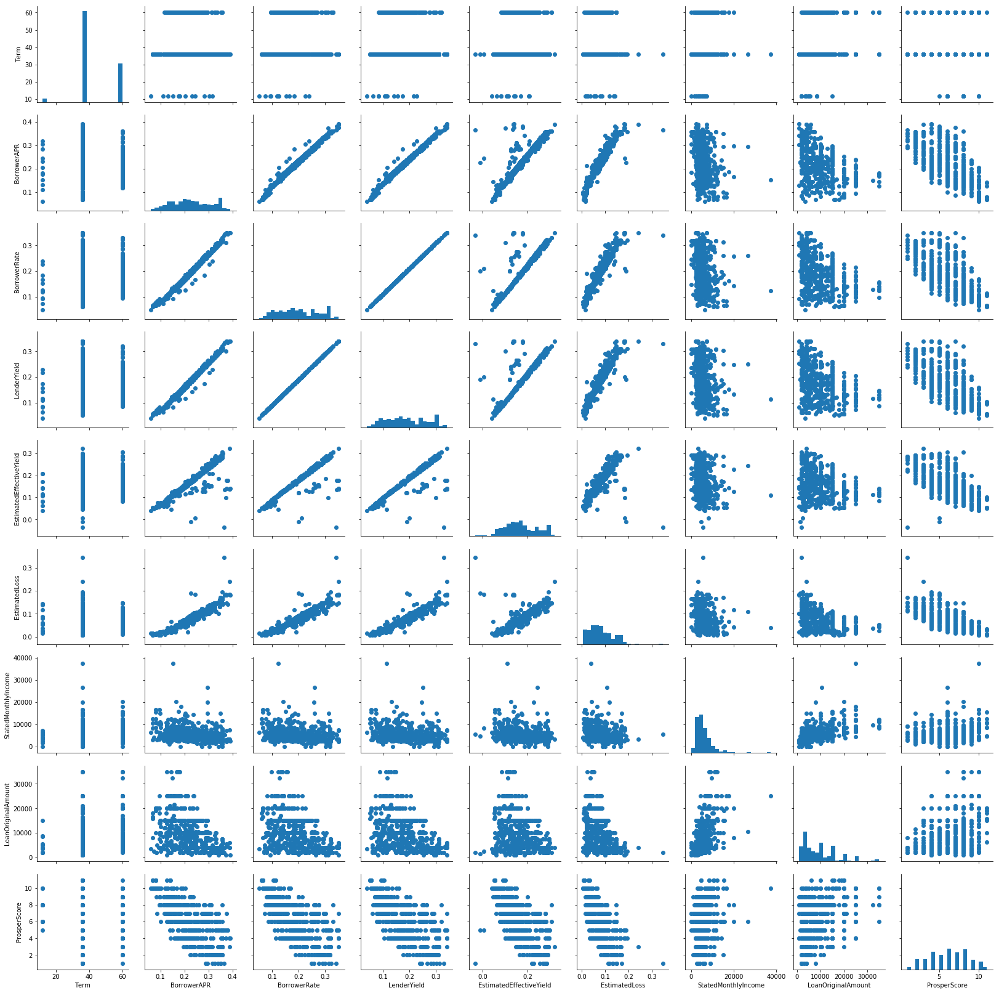

In [34]:
# plot matrix: sample 500 diamonds so that plots are clearer and
# they render faster
samples = np.random.choice(PLD.shape[0], 500, replace = False)
PLD_samp = PLD.loc[samples,:]

g = sb.PairGrid(data = PLD_samp, vars = numeric_vars)
g = g.map_diag(plt.hist, bins = 20);
g.map_offdiag(plt.scatter)

Matrix Plot: Similar to the correlation plot, we can determine which pair has negative or positive relationships from analyzing the pattern in each scatter plots. ProsperScore seems to be more related to BorrowerAPR compare to other variables. StatedMonthlyIncome does not give useful information on BorrowerAPR and will not be further analyzed.

C:\Users\mohamed3del\Anaconda3\lib\site-packages\seaborn\axisgrid.py:1241: UserWarning: The `size` paramter has been renamed to `height`; please update your code.
  warnings.warn(UserWarning(msg))


<Figure size 720x720 with 0 Axes>

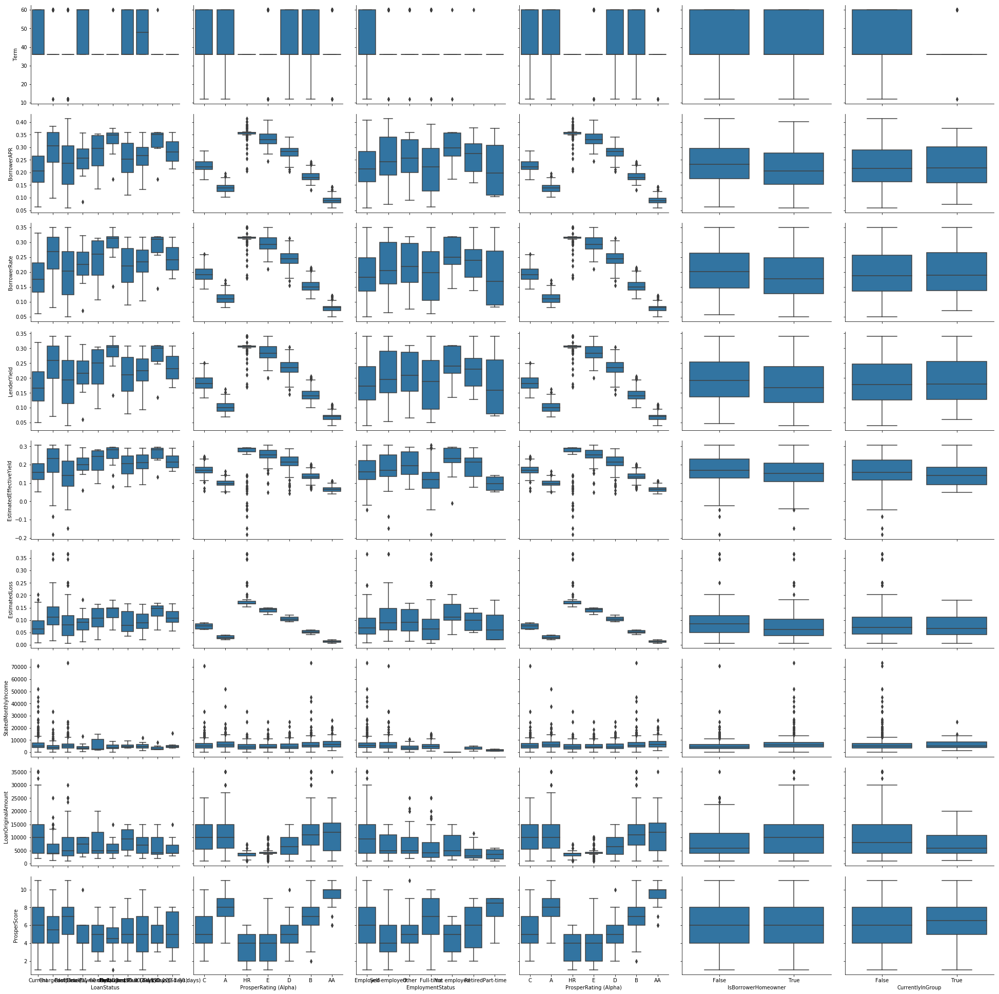

In [54]:
# plot matrix of numeric features against categorical features.
# can use a larger sample since there are fewer plots and they're simpler in nature.

samples = np.random.choice(PLD.shape[0], 2000, replace = False)
PLD_samp = PLD.loc[samples,:]

def boxgrid(x, y, **kwargs):
    """ Quick hack for creating box plots with seaborn's PairGrid. """
    default_color = sb.color_palette()[0]
    sb.boxplot(x, y, color = default_color)

plt.figure(figsize = [10, 10])
g = sb.PairGrid(data = PLD_samp, y_vars = numeric_vars , x_vars = categoric_vars,
                size = 3, aspect = 1.5)
g.map(boxgrid)
plt.show();

The figure shows that the loan amount is increased with the increase of loan term. The borrower APR decreases with the better rating. Borrowers with the best Prosper ratings have the lowest APR. It means that the Prosper rating has a strong effect on borrower APR. Borrowers with better rating also have larger monthly income and loan amount. Employed, self-employed and full time borrowers have more monthly income and loan amount than part-time, retired and not employed borrowers.

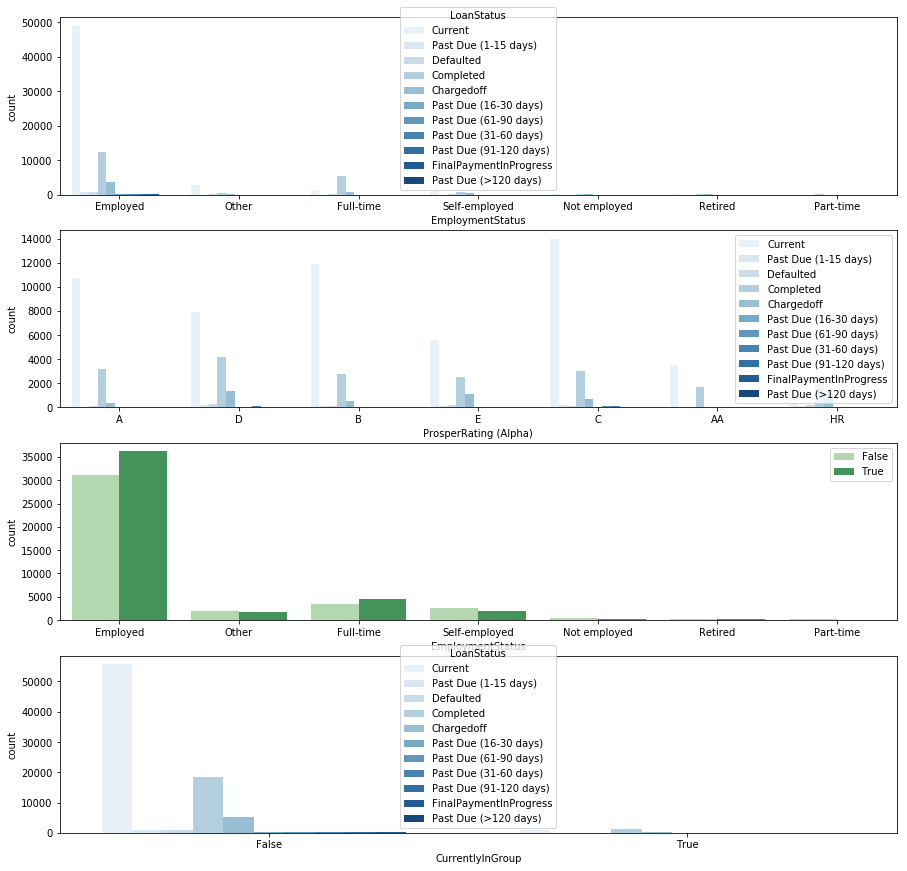

In [55]:
# since there's only three subplots to create, using the full data should be fine.
plt.figure(figsize = [15, 15])
x =['LoanStatus','ProsperRating (Alpha)','EmploymentStatus' ,'ProsperRating (Alpha)','IsBorrowerHomeowner','CurrentlyInGroup']
# subplot 1: LoanStatus vs EmploymentStatus
plt.subplot(4, 1, 1)
sb.countplot(data = PLD, x = 'EmploymentStatus', hue = 'LoanStatus', palette = 'Blues')

# subplot 2: LoanStatus vs. ProsperRating (Alpha)
ax = plt.subplot(4, 1, 2)
sb.countplot(data = PLD, x = 'ProsperRating (Alpha)', hue = 'LoanStatus', palette = 'Blues')
ax.legend(ncol = 1) # re-arrange legend to reduce overlapping

# subplot 3: EmploymentStatus vs. IsBorrowerHomeowner, use different color palette
ax = plt.subplot(4, 1, 3)
sb.countplot(data = PLD, x = 'EmploymentStatus', hue = 'IsBorrowerHomeowner', palette = 'Greens')
ax.legend(loc = 1, ncol = 1) # re-arrange legend to remove overlapping

# subplot 1: LoanStatus vs EmploymentStatus
plt.subplot(4, 1, 4)
sb.countplot(data = PLD, x = 'CurrentlyInGroup', hue = 'LoanStatus', palette = 'Blues')

plt.show()

most loaonstatus as current are for employed ones , has a 'c' rate for porsperRating (ALpha) and that employed ones most of them owend their iwen homes and not currently in group

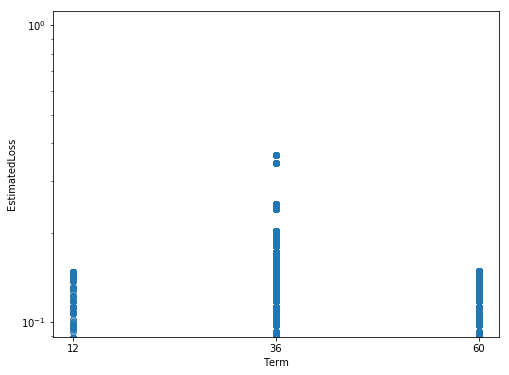

In [17]:
plt.figure(figsize = [8, 6])
plt.scatter(data = PLD, x = 'Term', y = 'EstimatedLoss' ,alpha= 1/10)
#plt.xlim([0, 3.5])
plt.xlabel('Term')
plt.xticks([12 ,36,60])
plt.yscale('log')
plt.ylabel('EstimatedLoss')
plt.show()

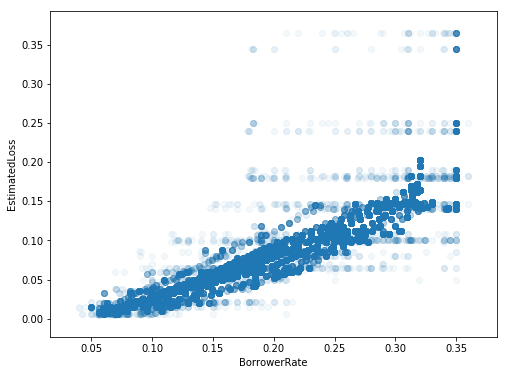

In [18]:
plt.figure(figsize = [8, 6])
plt.scatter(data = PLD, x = 'BorrowerRate', y = 'EstimatedLoss' ,alpha= 1/20)
#plt.xlim([0, 3.5])
plt.xlabel('BorrowerRate')
#plt.xticks([12 ,36,60])
#plt.yscale('log')
plt.ylabel('EstimatedLoss')
plt.show()

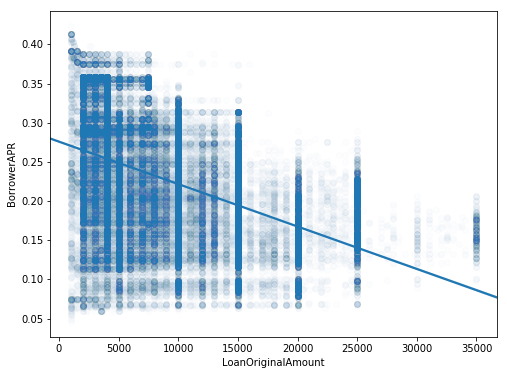

In [56]:
plt.figure(figsize = [8, 6])
sb.regplot(data = PLD, x = 'LoanOriginalAmount', y = 'BorrowerAPR', scatter_kws={'alpha':0.01});`

This plot shows that at different size of the loan amount, the APR has a large range, but the range of APR decrease with the increase of loan amount. Overall, the borrower APR is negatively correlated with loan amount.

### Talk about some of the relationships you observed in this part of the investigation. How did the feature(s) of interest vary with other features in the dataset?

>The APR of the borrower is negatively correlated with the original amount of the loan, which means that the larger the amount of the loan, the lower the APR. It also indicates that the APR has a wide range at the different size of the loan amount, but with the rise in the loan amount, the range of APR decreases. The rating of Prosper also has a clear influence on the APR of the applicant, which decreases with the better rating.

### Did you observe any interesting relationships between the other features (not the main feature(s) of interest)?

> The original amount of the loan is positively associated with the monthly income reported, because borrowers with more monthly income might lend more money, it makes sense. It also illustrates that better-rated borrowers also have greater monthly income and loan amounts. There is a relationship between a performance rating and a term. Proportionally, on B and C ratings, there are more 60-month loans. There are just 36 months of loans for borrowers with HR ratings.

## Multivariate Exploration

> Create plots of three or more variables to investigate your data even
further. Make sure that your investigations are justified, and follow from
your work in the previous sections.

C:\Users\mohamed3del\Anaconda3\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


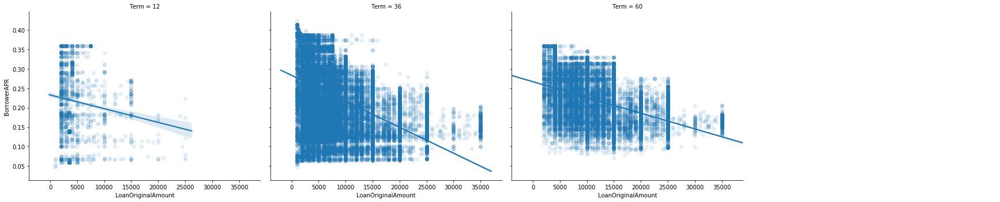

In [36]:
# Term effect on relationship of APR and loan amount
F=sb.FacetGrid(data=PLD, aspect=1.2, height=5, col='Term', col_wrap=4)
F.map(sb.regplot, 'LoanOriginalAmount', 'BorrowerAPR', x_jitter=0.04, scatter_kws={'alpha':0.1});
F.add_legend();

Term doesn't seem to have effect on relationship of APR and loan amount

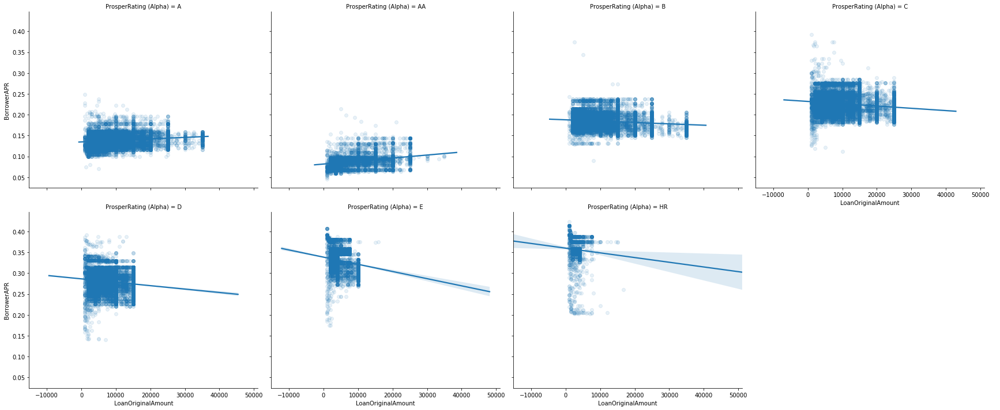

In [37]:
# Prosper rating effect on relationship of APR and loan amount
H=sb.FacetGrid(data=PLD, aspect=1.2, height=5, col='ProsperRating (Alpha)', col_wrap=4)
H.map(sb.regplot, 'LoanOriginalAmount', 'BorrowerAPR', x_jitter=0.04, scatter_kws={'alpha':0.1});
H.add_legend();

With prosper rating, the loan sum and borrower APR have a negative relationship and turns marginally to likely as prosperRating is lifted from HR to A or better. This could be because individuals with A or AA ratings want to borrow more cash, raising APR that may deter them from borrowing any further and optimising benefit. But lower-rated individuals prefer to borrow less money, and a decrease in APR might allow them to borrow more.

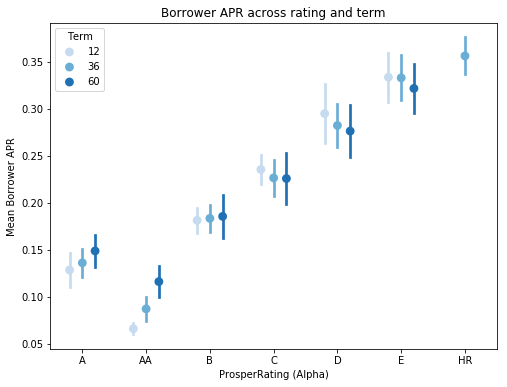

In [35]:
fig = plt.figure(figsize = [8,6])
ax = sb.pointplot(data = PLD, x = 'ProsperRating (Alpha)', y = 'BorrowerAPR', hue = 'Term',
           palette = 'Blues', linestyles = '', dodge = 0.4, ci='sd')
plt.title('Borrower APR across rating and term')
plt.ylabel('Mean Borrower APR')
ax.set_yticklabels([],minor = True);

Interestingly, the borrower APR decrease with the increase of borrow term for people with HR-C raings. But for people with B-AA ratings, the APR increase with the increase of borrow term.

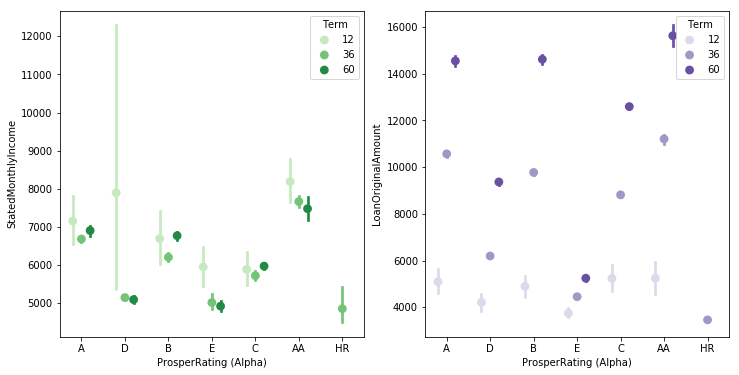

In [64]:
fig, ax = plt.subplots(ncols=2, figsize=[12,6])
sb.pointplot(data = PLD, x = 'ProsperRating (Alpha)', y = 'StatedMonthlyIncome', hue = 'Term',
           palette = 'Greens', linestyles = '', dodge = 0.4, ax=ax[0])
sb.pointplot(data = PLD, x = 'ProsperRating (Alpha)', y = 'LoanOriginalAmount', hue = 'Term',
           palette = 'Purples', linestyles = '', dodge = 0.4, ax=ax[1]);

 > there is a interaction between term and rating. We will see that with better Prosper rating, the loan amount of all three terms increases, the amplitude of loan amount between terms also becomes larger and it is increasing.
 > it doesn't seem like there is a interaction effect between term and rating, the consequences of term is similar among different ratings.


### Talk about some of the relationships you observed in this part of the investigation. Were there features that strengthened each other in terms of looking at your feature(s) of interest?

> I make my exploration analysis of borrower APR against loan amount by looking at the impact of the Prosper rating. The multivariate exploration showed that the relationship between borrower APR and loan amount turns from negative to slightly positive when the Prosper ratings increased from HR to AA I ,then i visualize the rating and term effects on loan amount, it is showing that if you have good Prosper rating, the loan amount of all three terms will be increase

### Were there any interesting or surprising interactions between features?

> there were a surprising interaction is that the borrower APR and loan amount is negatively correlated when the Prosper ratings are from HR to B, but the correlation is turned to be positive when the ratings are A and AA. Another interesting thing is that the borrower APR decrease with the increase of borrow term for people with HR-C raings. But for people with B-AA ratings, the APR increase with the borrow term.

> At the end of your report, make sure that you export the notebook as an
html file from the `File > Download as... > HTML` menu. Make sure you keep
track of where the exported file goes, so you can put it in the same folder
as this notebook for project submission. Also, make sure you remove all of
the quote-formatted guide notes like this one before you finish your report!